# Setup

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import laplace
from scipy.integrate import solve_bvp
from numba import njit
import time


import torch
from torch import nn
from torch.utils.data import DataLoader
from torchvision import datasets
from torchvision.transforms import ToTensor
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, TensorDataset
import torch.nn.functional as F

import plotly.graph_objs as go


from scipy.special import eval_legendre


from json import load
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using {device} device")


Using cuda device


# Load data

In [2]:
def reconstruct_harmonics(theta, C, L_max):
    cos_theta = np.cos(theta)
    V_out_reconstructed = np.zeros_like(theta)

    for l in range(L_max):
        P_l = eval_legendre(l, cos_theta)
        V_out_reconstructed += C[l] * P_l

    return V_out_reconstructed

def visualize_harmonics(theta, L_max, V_reconstructed):
    plt.figure(figsize=(10, 5))
    plt.plot(theta * 180 / np.pi, V_reconstructed, label=f'Rekonstrukcja z L_max={L_max}', lw=2, linestyle='--')
    plt.xlabel('theta θ')
    plt.ylabel('V_out(θ)')
    plt.title('Wizualizacja harmonik sferycznych')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


def pre_compute_P_coefficients(theta, L_max):
    cos_theta = np.cos(theta)
    P_l = np.zeros((L_max, len(theta)))  
    for l in range(L_max):
        P_l[l, :] = eval_legendre(l, cos_theta)
    return P_l


@njit
def compute_laplace_solution(r, theta, P_l, A, B, L_max):
    Nr = len(r)
    Nt = len(theta)

    result = np.zeros((Nt, Nr))
    
    for l in range(L_max):
        for i in range(Nt):
            for j in range(Nr):
                rj = r[j]
                result[i, j] += (A[l] * rj**l + B[l] * rj**(-l - 1)) * P_l[l, i]
    return result


def visualize_laplace_solution(r, theta, V_half):
    R, T = np.meshgrid(r, theta)
    X = R * np.sin(T)
    Y = R * np.cos(T)

    X_full = np.concatenate((-X[::-1, :], X), axis=0)
    Y_full = np.concatenate((Y[::-1, :], Y), axis=0)
    V_full = np.concatenate((V_half[::-1, :], V_half), axis=0)

    plt.figure(figsize=(8, 6))
    plt.pcolormesh(X_full, Y_full, V_full, shading='nearest', cmap='viridis')
    plt.colorbar(label='Φ(r, θ)')
    plt.title('Rozwiązanie równania Laplace’a')
    plt.xlabel('x')
    plt.ylabel('z')
    plt.gca().set_aspect('equal')
    plt.tight_layout()
    plt.show()



torch.Size([1600, 13]) torch.Size([1600, 20])
1553


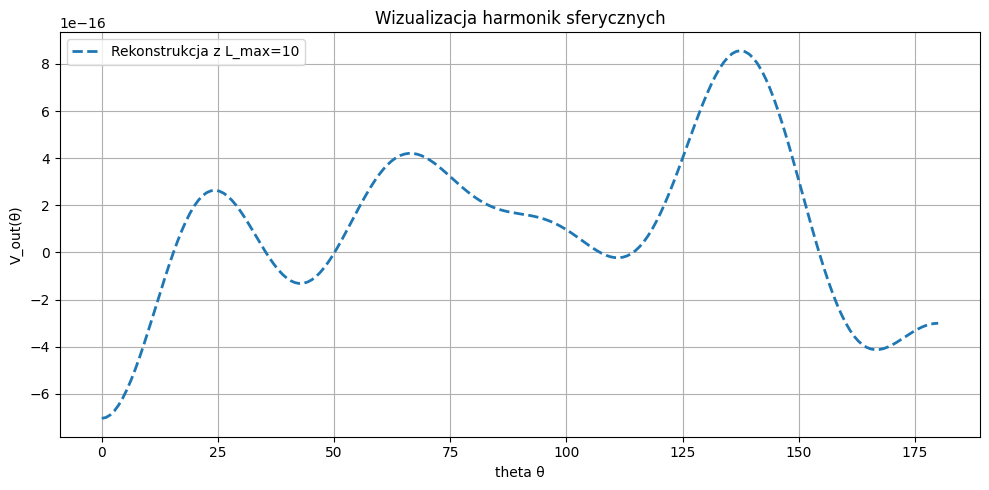

/tmp/ipykernel_27395/1537977766.py:56: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  plt.pcolormesh(X_full, Y_full, V_full, shading='nearest', cmap='viridis')


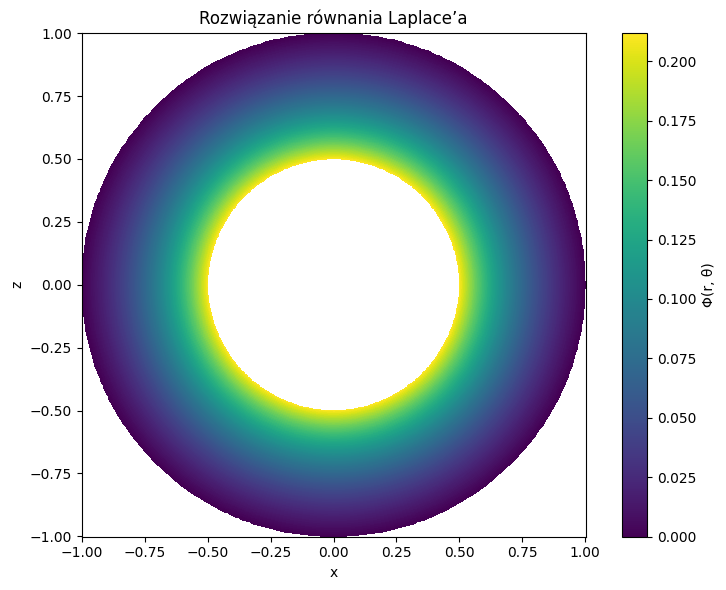

In [3]:

solutions = np.load("/home/ml_master/projects/PINN/solutions/sphere_symmetrical/solutions.npz")
X = solutions['X']
Y = solutions['Y']

X = torch.tensor(X, dtype=torch.float32)
Y = torch.tensor(Y, dtype=torch.float32)


X_train, X_test, y_train, y_test = train_test_split(
    X, Y,
    train_size=0.8,
    random_state=42
)

print(X_train.shape, y_train.shape)

i = np.random.randint(X_train.shape[0])
print(i)
X_sample, y_sample = X_train[i].numpy(), y_train[i].numpy()
R_in, R_out = X_sample[0], X_sample[1]
r = np.linspace(R_in, R_out, 200)
theta = np.linspace(0, np.pi, 200)
C = X_sample[3:]
L_max =  len(X_sample) - 3
A, B = y_sample[:L_max], y_sample[L_max:]


V_out_reconstructed = reconstruct_harmonics(theta, C, L_max)
visualize_harmonics(theta, L_max, V_out_reconstructed)

P_l = pre_compute_P_coefficients(theta, L_max)
V = compute_laplace_solution(r, theta, P_l, A, B, L_max)
visualize_laplace_solution(r, theta, V)

# Tools

In [18]:
def visualize_learning_curve(train_losses, test_losses):
    epochs = list(range(1, len(train_losses) + 1))

    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=epochs, y=train_losses,
        mode='lines+markers',
        name='Zbiór treningowy',
        line=dict(color='blue')
    ))

    fig.add_trace(go.Scatter(
        x=epochs, y=test_losses,
        mode='lines+markers',
        name='Zbiór testowy',
        line=dict(color='orange')
    ))

    fig.update_layout(
        title='Krzywa uczenia',
        xaxis_title='Epoka',
        yaxis_title='Strata',
        template='plotly_white',
        legend=dict(x=0.01, y=0.99),
        width=1200,   # szerokość w pikselach
        height=720   # wysokość w pikselach
    )

    fig.show()


def calculate_errors(model, boundaries_test, laplace_solutions_test):
    model.eval()

    mse_errors = []
    mae_errors = []
    kl_div_errors = []

    with torch.no_grad():
        for i in range(len(boundaries_test)):
            pred = model(boundaries_test[i]).squeeze(0)
            solution = laplace_solutions_test[i].squeeze(0)

            pred_log = F.log_softmax(pred, dim=1)
            solution_log = F.log_softmax(solution, dim=1)

            pred = pred.cpu().numpy()
            solution = solution.cpu().numpy()

            mse = mean_squared_error(solution.flatten(), pred.flatten())
            mse_errors.append(mse)

            # Mean Absolute Error
            mae = mean_absolute_error(solution.flatten(), pred.flatten())
            mae_errors.append(mae)

            # KL Divergence

            kl_loss = kl_loss_fn(pred_log, solution_log)
            kl_div_errors.append(kl_loss.item())

    mse_errors = np.array(mse_errors)
    mae_errors = np.array(mae_errors)
    kl_div_errors = np.array(kl_div_errors)

    print(f"Średni błąd MSE na całym test secie: {np.mean(mse_errors)}")
    print(f"Średni błąd MAE na całym test secie: {np.mean(mae_errors)}")
    print(f"Średni błąd KL Divergence na całym test secie: {np.mean(kl_div_errors)}")

    return mse_errors, mae_errors, kl_div_errors


def errors_plot(boundaries_test, mse_errors, mae_errors, kl_div_errors):
    boundaries_test_np = boundaries_test.cpu().numpy()

    fig, axs = plt.subplots(3, 3, figsize=(18, 12))

    row_labels = ["Amplitude", "Frequency", "Bias"]
    col_titles = ["MSE", "MAE", "KL Divergence"]
    errors = [mse_errors, mae_errors, kl_div_errors]
    colors = ["red", "blue", "green"]

    for row in range(3):  # 0: Amplitude, 1: Frequency, 2: Bias
        x = boundaries_test_np[:, row]
        for col in range(3):  # 0: MSE, 1: MAE, 2: KL
            ax = axs[row, col]
            ax.scatter(x, errors[col], s=2, color=colors[col])
            if row == 0:
                ax.set_title(col_titles[col])
            ax.set_xlabel(row_labels[row])
            ax.set_ylabel(col_titles[col])  # <-- poprawka tutaj
            ax.grid(True)

    plt.tight_layout()
    plt.show()

In [27]:
def get_random_sample_solutions(
        model,
        test_loader,
        x_scaler,
        y_scaler,
        pre_compute_P_coefficients,
        compute_laplace_solution,
        L_max,
        device,
        Nr=200,
        Nt=200
    ):
    """
    1) Losuje jedną próbkę z test_loader
    2) Robi predykcję współczynników, odskalowuje i liczy MSE
    3) Oblicza r, theta i półrozwiązania V_pred_half, V_true_half
    
    Zwraca:
      r, theta,
      V_pred_half (shape Nt×Nr),
      V_true_half (shape Nt×Nr),
      mse (float)
    """
    # --- pobranie i przygotowanie próbki ---
    x_batch, y_batch = next(iter(test_loader))
    i = np.random.randint(len(x_batch))
    x_sample = x_batch[i].unsqueeze(0).to(device)
    y_sample = y_batch[i].unsqueeze(0).to(device)

    # --- predykcja i odskalowanie ---
    model.eval()
    with torch.no_grad():
        pred_scaled = model(x_sample).cpu().numpy()
    pred = y_scaler.inverse_transform(pred_scaled)[0]

    sol_scaled = y_sample.cpu().numpy()
    solution = y_scaler.inverse_transform(sol_scaled)[0]

    
    mse = mean_squared_error(solution, pred)

    # rozdzielenie A, B
    A_pred, B_pred = pred[:L_max], pred[L_max:]
    A_true, B_true = solution[:L_max], solution[L_max:]

    # odskalowanie wejścia, wyciągnięcie R_in, R_out
    x0 = x_scaler.inverse_transform(x_sample.cpu().numpy())[0]
    R_in, R_out = x0[0], x0[1]

    # --- siatki i półrozwiązania ---
    r = np.linspace(R_in, R_out, Nr)
    theta = np.linspace(0, np.pi, Nt)
    P_l = pre_compute_P_coefficients(theta, L_max)

    V_pred_half = compute_laplace_solution(r, theta, P_l, A_pred, B_pred, L_max)
    V_true_half = compute_laplace_solution(r, theta, P_l, A_true, B_true, L_max)



    C = x0[2:]
    V_out_reconstructed = reconstruct_harmonics(theta, C, L_max)
    visualize_harmonics(theta, L_max, V_out_reconstructed)

    return r, theta, V_pred_half, V_true_half, mse


def visualize_comparison(r, theta, V_pred_half, V_true_half, cmap='viridis'):
    """
    Rysuje obok siebie:
      [0] mapa V_pred_full
      [1] mapa V_true_full
      [2] mapa błędu bezwzględnego |V_pred – V_true|
    """
    R, T = np.meshgrid(r, theta)
    X = R * np.sin(T)
    Y = R * np.cos(T)

    # odbicie, żeby mieć pełne [-x..x]
    X_full = np.concatenate((-X[::-1, :], X), axis=0)
    Y_full = np.concatenate(( Y[::-1, :], Y), axis=0)

    Vp = np.concatenate((V_pred_half[::-1, :], V_pred_half), axis=0)
    Vt = np.concatenate((V_true_half[::-1, :],  V_true_half ), axis=0)
    Verr = np.abs(Vp - Vt)

    titles = ['predykcja', 'referencja', 'Różnica MAE']
    data   = [Vp, Vt, Verr]

    fig, axs = plt.subplots(1, 3, figsize=(14, 5), constrained_layout=True)
    for ax, Z, title in zip(axs, data, titles):
        im = ax.pcolormesh(X_full, Y_full, Z, shading='nearest', cmap=cmap)
        ax.set_aspect('equal')
        ax.set_title(title)
        ax.set_xlabel('x')
        ax.set_ylabel('z')
        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    plt.show()


def plot_sector_errors(
    r,
    theta,
    V_pred_half,
    V_true_half,
    sector_angles_deg=None,
    error_type='relative',
    eps=1e-8
):
    """
    Rysuje w Plotly średni błąd vs r w 4 sektorach kątowych:
     – 0–45°, 45–90°, 90–135°, 135–180°.

    Parametry:
      r:               1D array długości Nr – promienie.
      theta:           1D array długości Nt – kąty w radianach [0..π].
      V_pred_half:     tablica (Nt, Nr) – predykcja.
      V_true_half:     tablica (Nt, Nr) – rozwiązanie dokładne.
      sector_angles_deg: lista brzegów sektorów w stopniach,
                        domyślnie [0,45,90,135,180].
      error_type:      'absolute' lub 'relative'.
                       – 'absolute':  err = |V_pred – V_true|
                       – 'relative':  err = |V_pred – V_true| / (|V_true|+eps) *100 [%]
      eps:             mała stała dla stabilności dzielenia.

    Funkcja liczy błąd w każdym sektorze jako mean(err[theta ∈ sektor], axis=0)
    i rysuje cztery krzywe, które można przełączać w legendzie.
    """
    if sector_angles_deg is None:
        sector_angles_deg = [0, 45, 90, 135, 180]
    # krawędzie w radianach
    edges = np.deg2rad(sector_angles_deg)

    # 1) oblicz macierz błędu (Nt×Nr)
    if error_type == 'absolute':
        E = np.abs(V_pred_half - V_true_half)
        y_axis_title = "Błąd bezwzględny"
    elif error_type == 'relative':
        E = np.abs(V_pred_half - V_true_half) / (np.abs(V_true_half) + eps) * 100
        y_axis_title = "Błąd względny [%]"
    else:
        raise ValueError("error_type musi być 'absolute' lub 'relative'")

    # 2) średnia po theta w każdym sektorze
    fig = go.Figure()
    for k in range(len(edges)-1):
        t_min, t_max = edges[k], edges[k+1]
        mask = (theta >= t_min) & (theta < t_max)
        if not np.any(mask):
            continue
        # średnia w pionie (po maskowanych wierszach)
        err_vs_r = E[mask, :].mean(axis=0)  # shape (Nr,)
        label = f"{sector_angles_deg[k]}°–{sector_angles_deg[k+1]}°"
        fig.add_trace(go.Scatter(
            x=r,
            y=err_vs_r,
            mode='lines',
            name=label
        ))

    fig.update_layout(
        title=f"{y_axis_title} w funkcji r w sektorach kątowych",
        xaxis_title="r",
        yaxis_title=y_axis_title,
        legend_title="Sektor",
        hovermode="x unified",
        width=1200,   # szerokość w pikselach
        height=720
    )
    fig.show()

In [20]:
def plot_radial_sector_errors(
    r,
    theta,
    V_pred_half,
    V_true_half,
    sector_edges=None,
    error_type='absolute',
    eps=1e-8
):
    """
    Rysuje w Plotly średni błąd vs θ w 4 pierścieniach (radial sectors):

      r_min–r_1, r_1–r_2, r_2–r_3, r_3–r_max

    Parametry:
      r:               1D array długości Nr – promienie.
      theta:           1D array długości Nt – kąty w radianach [0..π].
      V_pred_half:     tablica (Nt, Nr) – predykcja.
      V_true_half:     tablica (Nt, Nr) – rozwiązanie dokładne.
      sector_edges:    1D array długości 5 z wartościami granic (r),
                       domyślnie równomiernie w [r.min(), r.max()].
      error_type:      'absolute' lub 'relative'.
                       – 'absolute':  err = |V_pred – V_true|
                       – 'relative':  err = |V_pred – V_true|/(|V_true|+eps)*100 [%]
      eps:             mała stała dla stabilności dzielenia.

    Funkcja liczy błąd w każdym pierścieniu jako mean(err[:, j] dla r[j] ∈ sektor)
    i rysuje cztery krzywe błędu jako funkcję θ.
    """
    # 1) przygotuj granice pierścieni
    if sector_edges is None:
        sector_edges = np.linspace(r.min(), r.max(), 5)
    else:
        sector_edges = np.array(sector_edges)
        assert len(sector_edges) == 5, "sector_edges musi mieć dokładnie 5 wartości"

    # 2) oblicz macierz błędu
    if error_type == 'absolute':
        E = np.abs(V_pred_half - V_true_half)
        y_title = "Błąd bezwzględny"
    elif error_type == 'relative':
        E = np.abs(V_pred_half - V_true_half) / (np.abs(V_true_half) + eps) * 100
        y_title = "Błąd względny [%]"
    else:
        raise ValueError("error_type musi być 'absolute' lub 'relative'")

    # 3) średnia po r w każdym pierścieniu, wykres vs θ
    fig = go.Figure()
    for k in range(4):
        r_min, r_max = sector_edges[k], sector_edges[k+1]
        mask = (r >= r_min) & (r < r_max)
        if not np.any(mask):
            continue
        err_vs_theta = E[:, mask].mean(axis=1)  # średnio po kolumnach r
        label = f"{r_min:.2f}–{r_max:.2f}"
        fig.add_trace(go.Scatter(
            x=np.rad2deg(theta),
            y=err_vs_theta,
            mode='lines',
            name=label
        ))

    fig.update_layout(
        title=f"{y_title} w funkcji kąta θ dla radialnych sektorów",
        xaxis_title="θ [°]",
        yaxis_title=y_title,
        legend_title="Pierścień r",
        hovermode="x unified",
        width=1200,   # szerokość w pikselach
        height=720
    )
    fig.show()


In [21]:
def plot_hemisphere_hotspots(
    r,
    theta,
    V_pred_half,
    V_true_half,
    phi_count: int = 36,
    threshold_pct: float = 3.0,
    min_true_value: float = 1e-6
):
    """
    Zaznacza w objętości półsfery (φ∈[0,π]) punkty, gdzie
    względny błąd |V_pred–V_true|/|V_true|*100 > threshold_pct.

    Parametry:
      r            – 1D-array promieni (Nr), od R_in do R_out.
      theta        – 1D-array kątów polar [0..π] (Nt).
      V_pred_half  – tablica (Nt×Nr) – predykcja.
      V_true_half  – tablica (Nt×Nr) – prawdziwe rozwiązanie.
      phi_count    – liczba punktów w azymucie φ na każdy hotspot.
      threshold_pct– próg błędu względnego [%].
      min_true_value – minimalna |V_true|, poniżej której pomijamy punkt.

    Dla każdej pary (i_theta, j_r) z błędem > threshold
    generuje punkty w azymucie φ∈[0,π] i rysuje je jako czerwone Scatter3d.
    """
    # maksymalny promień
    R_out = r[-1]

    # 1) oblicz względny błąd na półmapie (Nt×Nr)
    true_vals = V_true_half
    pred_vals = V_pred_half
    valid = np.abs(true_vals) > min_true_value
    rel_err = np.zeros_like(true_vals)
    rel_err[valid] = (
        np.abs(pred_vals[valid] - true_vals[valid]) /
        np.abs(true_vals[valid]) * 100
    )

    # 2) weź wszystkie (i,j) gdzie rel_err > threshold
    hotspots = np.argwhere(rel_err > threshold_pct)
    if hotspots.size == 0:
        print(f"Brak punktów z błędem > {threshold_pct}% w półsferze.")
        return

    # 3) wektor φ tylko do π (półsfera)
    phi = np.linspace(0, np.pi, phi_count, endpoint=True)

    xs, ys, zs = [], [], []
    for i, j in hotspots:
        ri = r[j]
        ti = theta[i]
        sin_t, cos_t = np.sin(ti), np.cos(ti)
        # punkty na okręgu (φ∈[0,π]) w odległości ri, kącie ti
        xs.append((ri * sin_t * np.cos(phi)))
        ys.append((ri * sin_t * np.sin(phi)))
        zs.append((ri * cos_t * np.ones_like(phi)))

    xs = np.concatenate(xs)
    ys = np.concatenate(ys)
    zs = np.concatenate(zs)

    fig = go.Figure(go.Scatter3d(
        x=xs, y=ys, z=zs,
        mode='markers',
        marker=dict(size=3, color='red'),
        name=f'Hotspoty >{threshold_pct}%'
    ))
    fig.update_layout(
        title=f"Hotspoty błędu względnego >{threshold_pct}% w półsferze",
        scene=dict(
            xaxis_title='X', yaxis_title='Y', zaxis_title='Z',
            aspectmode='data'
        )
    )
    fig.show()

# Model 

In [22]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class LaplaceNet(nn.Module):
    def __init__(self, L_max):
        super().__init__()

        self.input_shape = L_max + 3
        self.output_shape = L_max * 2

        self.net = nn.Sequential(
            nn.Linear(self.input_shape, 128),
            nn.ReLU(),

            nn.Linear(128, 256),
            nn.ReLU(),

            nn.Linear(256, 512),
            nn.ReLU(),

            nn.Linear(512, 1024),
            nn.ReLU(),

            nn.Linear(1024, 2048),
            nn.ReLU(),

            nn.Linear(2048, self.output_shape)
        )

    def forward(self, x):
        return self.net(x)


def train(train_loader, model, loss_fn, optimizer, steps_per_epoch):
    model.train()
    total_loss = 0
    steps_per_epoch = steps_per_epoch if steps_per_epoch else len(train_loader)

    for batch_idx, (input, output) in enumerate(train_loader):
      pred = model(input)

      loss = loss_fn(pred, output)


      loss.backward()
      optimizer.step()
      optimizer.zero_grad()
      total_loss += loss

      if batch_idx + 1 >= steps_per_epoch:
            break
    return total_loss / steps_per_epoch


def test(test_loader, model, loss_fn):
    model.eval()
    test_loss = 0

    with torch.no_grad():
       for batch_idx, (input, output) in enumerate(test_loader):
            pred = model(input)
            loss = loss_fn(pred, output)
            test_loss += loss

    return test_loss / len(test_loader)

In [23]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler


class CosineLoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.cos = nn.CosineSimilarity(dim=1, eps=1e-8)
    
    def forward(self, pred, target):
        cos_sim = self.cos(pred, target)  # [batch_size]
        loss = 1 - cos_sim                # [batch_size]
        return loss.mean()                # zwraca skalara


class RelativeMSELoss(nn.Module):
    def __init__(self, eps=1e-8):
        super().__init__()
        self.eps = eps
        
    def forward(self, pred, target):
        mse = torch.mean((pred - target)**2)
        denom = torch.mean(target**2)
        return mse / (denom + self.eps)





load_from_file = False
save_model = False
model_path = "/content/drive/MyDrive/STUDIA/magisterka/models/model_1.pth"


batch_size = 32
L_max = 10

if load_from_file:
  model = LaplaceNet(L_max=L_max).to(device)
  model.load_state_dict(torch.load(model_path))
  model.eval()

else:
  model = LaplaceNet(L_max=L_max).to(device)
  optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
  scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, min_lr=1e-5)

  # loss_fn = nn.MSELoss()
  loss_fn = nn.L1Loss()
  # loss_fn = CosineLoss()
  # loss_fn = RelativeMSELoss() 

  x_scaler = MinMaxScaler()
  y_scaler = MinMaxScaler()

  X_train_np = X_train.cpu().numpy()
  X_test_np = X_test.cpu().numpy()
  y_train_np = y_train.cpu().numpy()
  y_test_np = y_test.cpu().numpy()

  X_train_scaled = x_scaler.fit_transform(X_train_np)
  X_test_scaled = x_scaler.transform(X_test_np)
  y_train_scaled = y_scaler.fit_transform(y_train_np)
  y_test_scaled = y_scaler.transform(y_test_np)

  ### SKALOWANIE — KONWERSJA Z POWROTEM DO TENSORÓW
  X_train_tensor = torch.tensor(X_train_scaled, dtype=torch.float32).to(device)
  X_test_tensor = torch.tensor(X_test_scaled, dtype=torch.float32).to(device)
  y_train_tensor = torch.tensor(y_train_scaled, dtype=torch.float32).to(device)
  y_test_tensor = torch.tensor(y_test_scaled, dtype=torch.float32).to(device)

  ### TWORZENIE ZESTAWÓW DANYCH
  train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
  train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
  test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
  test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


  epochs = 100
  train_losses, test_losses = [], []

  for t in range(epochs):
    start = time.time()
    print(f"Epoch {t+1}\n-------------------------------")

    train_loss = train(train_loader, model, loss_fn, optimizer, steps_per_epoch=None)
    scheduler.step(train_loss)
    train_losses.append(train_loss.cpu().detach().numpy())

    test_loss = test(test_loader, model, loss_fn)
    test_losses.append(test_loss.cpu().detach().numpy())

    print(f"Train loss: {train_loss:.5f},     test loss: {test_loss:.5f},     train time: {time.time() - start:.3f}s")

    if save_model:
      torch.save(model.state_dict(), model_path)
  visualize_learning_curve(train_losses, test_losses)

Epoch 1
-------------------------------
Train loss: 0.13832,     test loss: 0.09926,     train time: 0.169s
Epoch 2
-------------------------------
Train loss: 0.09425,     test loss: 0.08318,     train time: 0.087s
Epoch 3
-------------------------------
Train loss: 0.07069,     test loss: 0.05785,     train time: 0.086s
Epoch 4
-------------------------------
Train loss: 0.05273,     test loss: 0.04326,     train time: 0.084s
Epoch 5
-------------------------------
Train loss: 0.04110,     test loss: 0.03854,     train time: 0.084s
Epoch 6
-------------------------------
Train loss: 0.03571,     test loss: 0.03390,     train time: 0.082s
Epoch 7
-------------------------------
Train loss: 0.03035,     test loss: 0.02335,     train time: 0.081s
Epoch 8
-------------------------------
Train loss: 0.02669,     test loss: 0.02437,     train time: 0.084s
Epoch 9
-------------------------------
Train loss: 0.02523,     test loss: 0.02111,     train time: 0.081s
Epoch 10
-------------------

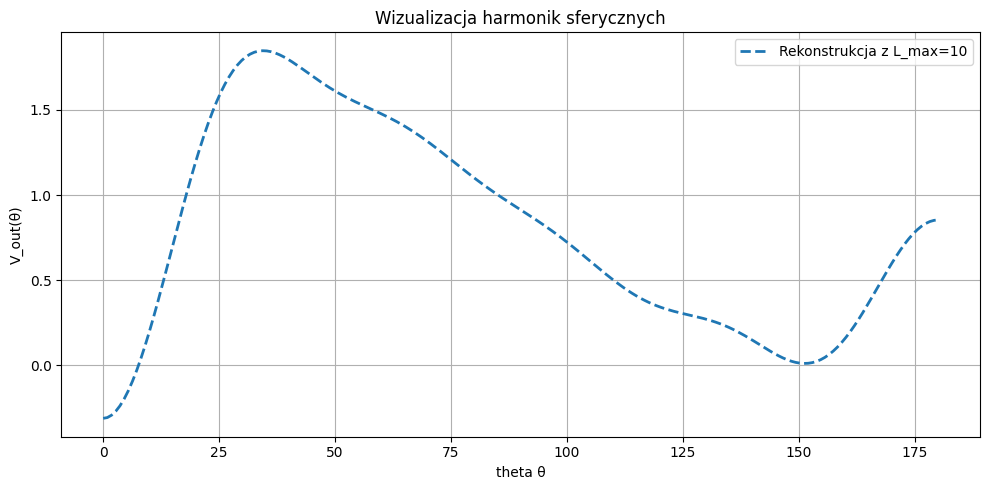

MSE współczynników: 0.000103


/tmp/ipykernel_27395/1985601570.py:91: UserWarning:

The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.



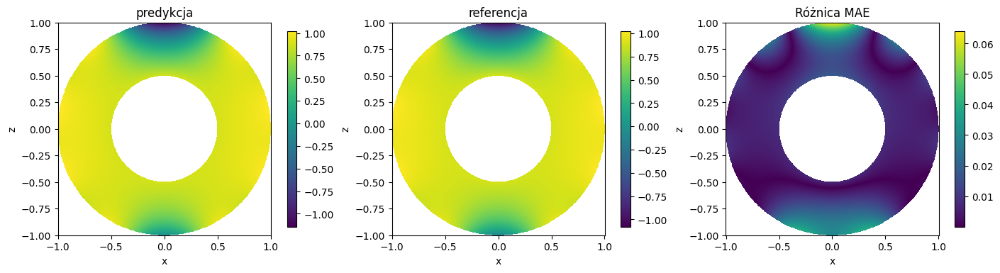

In [29]:
r, theta, V_pred_half, V_true_half, mse = get_random_sample_solutions(
    model=model,
    test_loader=test_loader,
    x_scaler=x_scaler,
    y_scaler=y_scaler,
    pre_compute_P_coefficients=pre_compute_P_coefficients,
    compute_laplace_solution=compute_laplace_solution,
    L_max=L_max,
    device=device
)

print(f"MSE współczynników: {mse:.6f}")

# 1) porównanie map
visualize_comparison(r, theta, V_pred_half, V_true_half)

# 1) średni błąd bezwzględny
plot_sector_errors(r, theta, V_pred_half, V_true_half,
                   error_type='absolute')


plot_sector_errors(r, theta, V_pred_half, V_true_half,
                   error_type='relative')

# Błąd bezwzględny vs theta
plot_radial_sector_errors(
    r, theta, V_pred_half, V_true_half,
    error_type='absolute'
)


# Błąd bezwzględny vs theta
plot_radial_sector_errors(
    r, theta, V_pred_half, V_true_half,
    error_type='relative'
)



In [36]:


plot_hemisphere_hotspots(
    r, theta, V_pred_half, V_true_half,
    phi_count=10,
    threshold_pct=3.0,
    min_true_value=1e-3
)